In [1]:
%matplotlib inline
%reload_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'retina'

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
import seaborn as sns
import logging

import logging
import sys

def setup_logging(epoch_key, date_format='%d-%b-%y %H:%M:%S', format='%(asctime)s %(message)s'):
    animal, day, epoch = epoch_key
    log_filename = f"{animal}_{day:02d}_{epoch:02d}.log"

    logger = logging.getLogger()
    logger.setLevel(logging.INFO)
    formatter = logging.Formatter(fmt=format, datefmt=date_format)

    stdout_handler = logging.StreamHandler(sys.stdout)
    stdout_handler.setLevel(logging.INFO)
    stdout_handler.setFormatter(formatter)

    file_handler = logging.FileHandler(log_filename)
    file_handler.setLevel(logging.INFO)
    file_handler.setFormatter(formatter)

    logger.addHandler(file_handler)
    logger.addHandler(stdout_handler)

sns.set_context("talk")

In [3]:
epoch_key = 'Jaq', 3, 12

In [4]:
setup_logging(epoch_key)

In [5]:
from dask.distributed import Client

# for virga
client = Client(n_workers=28, threads_per_worker=2, processes=True)

client

Client Scheduler: tcp://127.0.0.1:46438 Dashboard: http://127.0.0.1:8787/status,Cluster Workers: 28 Cores: 56 Memory: 404.32 GB


In [6]:
from src.load_data import load_data


data = load_data(epoch_key,
                 position_to_linearize=['nose_x', 'nose_y'],
                 max_distance_from_well=5,
                 min_distance_traveled=30)

23-May-21 21:13:02 Loading position info...
23-May-21 21:13:43 Loading multiunit...
23-May-21 21:14:12 Loading spikes...
23-May-21 21:15:50 Finding ripple times...


In [7]:
continuous_transition_types = (
    [['random_walk', 'uniform'],
     ['uniform',     'uniform']])


classifier_parameters = {
    'movement_var': 6.0,
    'replay_speed': 1,
    'place_bin_size': 2.5,
    'continuous_transition_types': continuous_transition_types,
    'discrete_transition_diag': 0.968,
    'knot_spacing': 8,
    'spike_model_penalty': 0.5,
}

In [8]:
from replay_trajectory_classification.core import _causal_classify, _acausal_classify, scaled_likelihood


def poisson_log_likelihood(spikes, conditional_intensity):
    """Probability of parameters given spiking at a particular time.

    Parameters
    ----------
    spikes : ndarray, shape (n_time,)
        Indicator of spike or no spike at current time.
    conditional_intensity : ndarray, shape (n_place_bins,)
        Instantaneous probability of observing a spike

    Returns
    -------
    poisson_log_likelihood : array_like, shape (n_time, n_place_bins)

    """
    return (np.log(conditional_intensity[np.newaxis, :] + np.spacing(1)) *
            spikes[:, np.newaxis])


def combined_likelihood(spikes, conditional_intensity):
    '''

    Parameters
    ----------
    spikes : ndarray, shape (n_time, n_neurons)
    conditional_intensity : ndarray, shape (n_bins, n_neurons)

    '''
    n_time = spikes.shape[0]
    n_bins = conditional_intensity.shape[0]
    log_likelihood = np.zeros((n_time, n_bins))

    for is_spike, ci in zip(spikes.T, conditional_intensity.T):
        log_likelihood += poisson_log_likelihood(is_spike, ci)

    return log_likelihood


def estimate_spiking_likelihood(spikes, conditional_intensity,
                                is_track_interior=None):
    '''

    Parameters
    ----------
    spikes : ndarray, shape (n_time, n_neurons)
    conditional_intensity : ndarray, shape (n_bins, n_neurons)
    is_track_interior : None or ndarray, optional, shape (n_x_position_bins,
                                                          n_y_position_bins)
    Returns
    -------
    likelihood : ndarray, shape (n_time, n_bins)
    '''
    if is_track_interior is not None:
        is_track_interior = is_track_interior.ravel(order='F')
    else:
        n_bins = conditional_intensity.shape[0]
        is_track_interior = np.ones((n_bins,), dtype=np.bool)

    log_likelihood = combined_likelihood(spikes, conditional_intensity)

    mask = np.ones_like(is_track_interior, dtype=np.float)
    mask[~is_track_interior] = np.nan

    return log_likelihood * mask

def predict(classifier, spikes, time=None, is_compute_acausal=True,
            state_names=None):
    '''

    Parameters
    ----------
    spikes : ndarray, shape (n_time, n_neurons)
    time : ndarray or None, shape (n_time,), optional
    is_compute_acausal : bool, optional
    state_names : None or array_like, shape (n_states,)

    Returns
    -------
    results : xarray.Dataset

    '''
    spikes = np.asarray(spikes)

    results = {}

    likelihood = {}
    for encoding_group in np.asarray(classifier.place_fields_.encoding_group):
        likelihood[encoding_group] = estimate_spiking_likelihood(
            spikes,
            np.asarray(classifier.place_fields_.sel(
                encoding_group=encoding_group)),
            classifier.is_track_interior_)

    results['likelihood'] = np.stack(
        [likelihood[encoding_group]
         for encoding_group in classifier.encoding_group_to_state_],
        axis=1)
    
    results['likelihood'] = scaled_likelihood(
        results['likelihood'], axis=(1, 2))[..., np.newaxis]

    results['causal_posterior'] = _causal_classify(
        classifier.initial_conditions_, classifier.continuous_state_transition_,
        classifier.discrete_state_transition_, results['likelihood'])

    if is_compute_acausal:
        results['acausal_posterior'] = _acausal_classify(
            results['causal_posterior'], classifier.continuous_state_transition_,
            classifier.discrete_state_transition_)

    n_time = spikes.shape[0]

    if time is None:
        time = np.arange(n_time)

    return classifier.convert_results_to_xarray(results, time, state_names)

In [ ]:
from replay_trajectory_classification import SortedSpikesClassifier
from src.parameters import WTRACK_EDGE_ORDER, WTRACK_EDGE_SPACING, PROCESSED_DATA_DIR

from sklearn.model_selection import KFold
import os

state_names = ['Continuous', 'Fragmented']
cv = KFold()
results = []

for fold_ind, (train, test) in enumerate(cv.split(data["position_info"].index)):
    logging.info(f'Fitting Fold #{fold_ind + 1}...')
    classifier = SortedSpikesClassifier(**classifier_parameters)
    classifier.fit(
        position=data["position_info"].iloc[train].linear_position,
        spikes=data["spikes"].iloc[train],
        track_graph=data["track_graph"],
        edge_order=WTRACK_EDGE_ORDER,
        edge_spacing=WTRACK_EDGE_SPACING,
    )
    classifier.save_model(
        os.path.join(PROCESSED_DATA_DIR,
            f"{epoch_key[0]}_{epoch_key[1]:02d}_{epoch_key[2]:02d}_"
            f"sortedspikes_flat_nospike2_fold{fold_ind}_model.pkl")
    )

    logging.info('Predicting posterior...')
    results.append(
        predict(classifier,
            data["spikes"].iloc[test],
            time=data["position_info"].iloc[test].index / np.timedelta64(1, "s"),
            state_names=state_names
        )
    )
    
# concatenate results 
results = xr.concat(
    results, dim="time"
)

# save the results as .nc format. ncread matlab can read these
results.to_netcdf(
    os.path.join(PROCESSED_DATA_DIR,
   f"{epoch_key[0]}_{epoch_key[1]:02d}_{epoch_key[2]:02d}_sortedspikes_flat_nospike2_results.nc")
)
logging.info('Done...\n\n')

23-May-21 21:16:41 Fitting Fold #1...
23-May-21 21:16:42 Fitting initial conditions...
23-May-21 21:16:43 Fitting state transition...
23-May-21 21:16:43 Fitting place fields...
23-May-21 21:25:44 Predicting posterior...


In [ ]:
client.close()

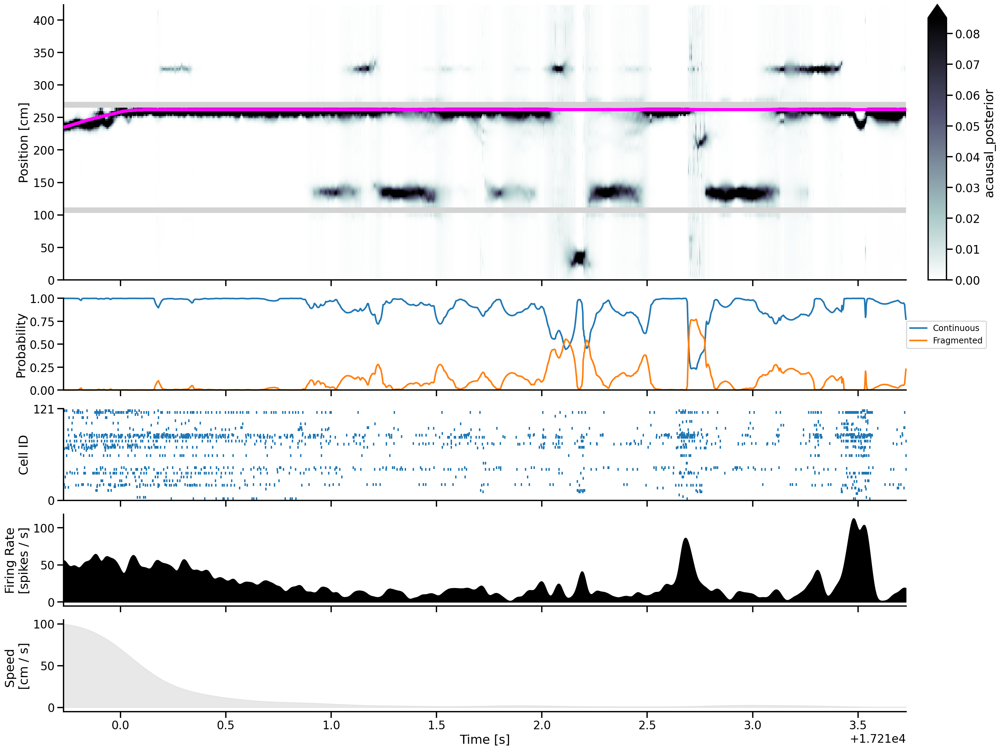

In [19]:
from src.visualization import plot_classifier_spikes

plot_classifier_spikes(
    results.time[slice(424_000, 426_000)],
    classifier,
    results,
    data,
    posterior_type="acausal_posterior",
    figsize=(20, 15),
    legend=True,
)

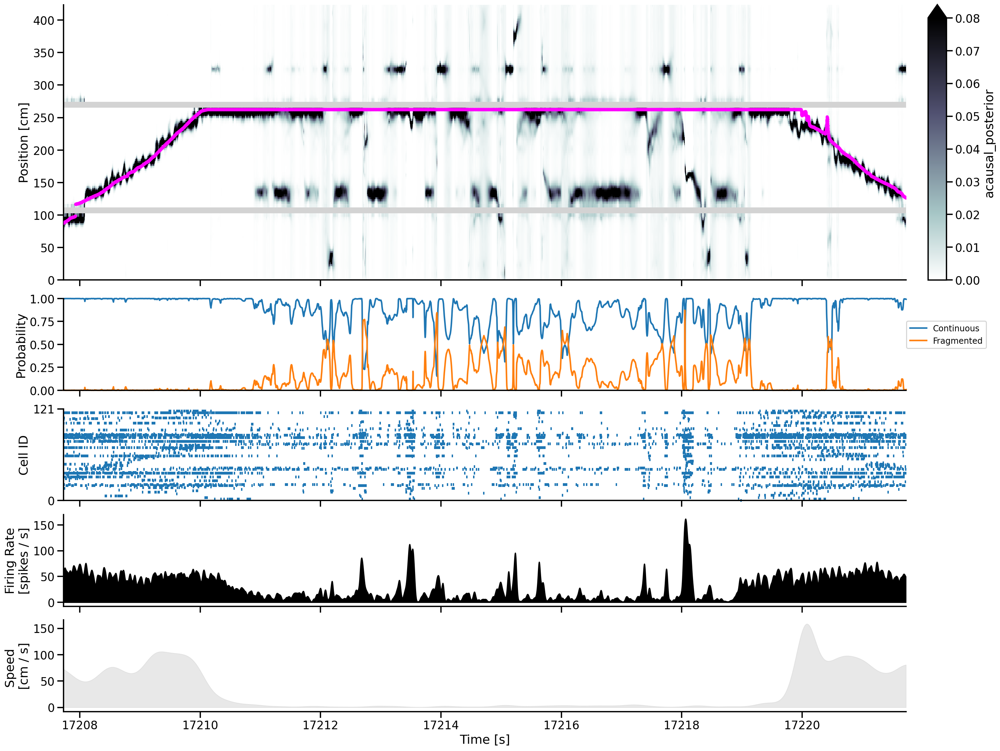

In [20]:
from src.visualization import plot_classifier_spikes

plot_classifier_spikes(
    results.time[slice(423_000, 430_000)],
    classifier,
    results,
    data,
    posterior_type="acausal_posterior",
    figsize=(20, 15),
    legend=True,
)

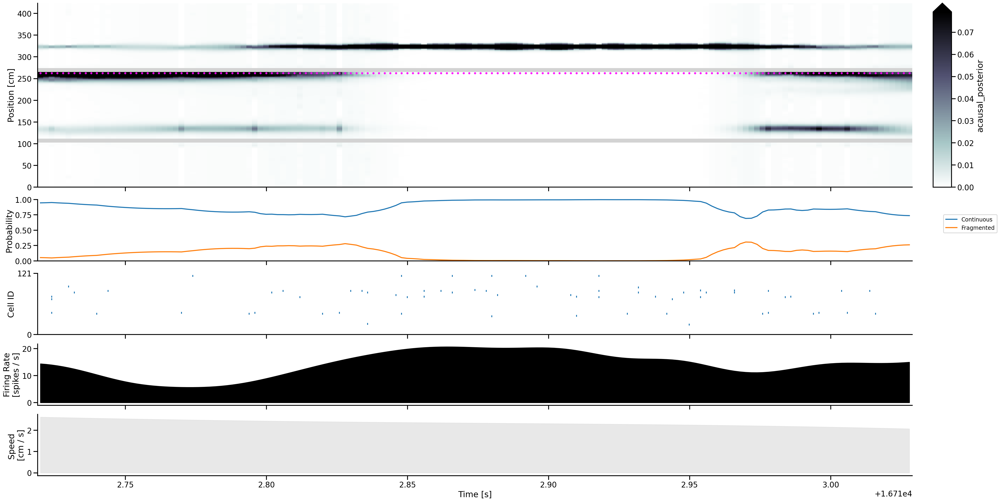

In [21]:
from src.visualization import plot_classifier_spikes

plot_classifier_spikes(
    results.time[slice(175_495, 175_650)],
    classifier,
    results,
    data,
    posterior_type="acausal_posterior",
    figsize=(30, 15),
    legend=True,
)

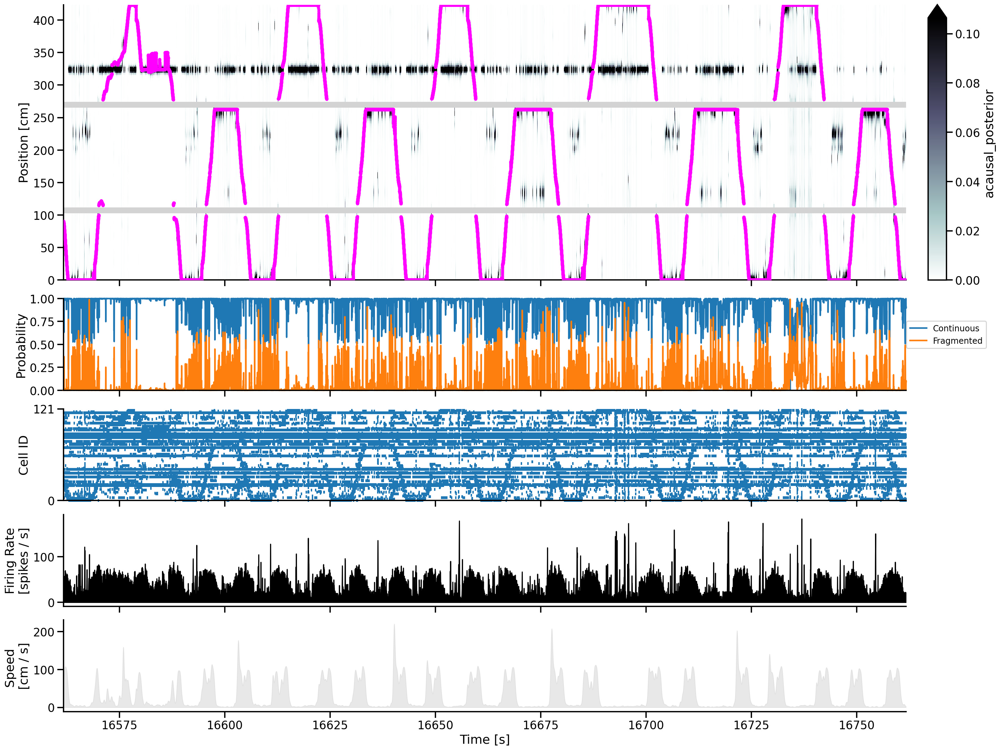

In [22]:
from src.visualization import plot_classifier_spikes

plot_classifier_spikes(
    results.time[slice(100_000, 200_000)],
    classifier,
    results,
    data,
    posterior_type="acausal_posterior",
    figsize=(20, 15),
    legend=True,
)

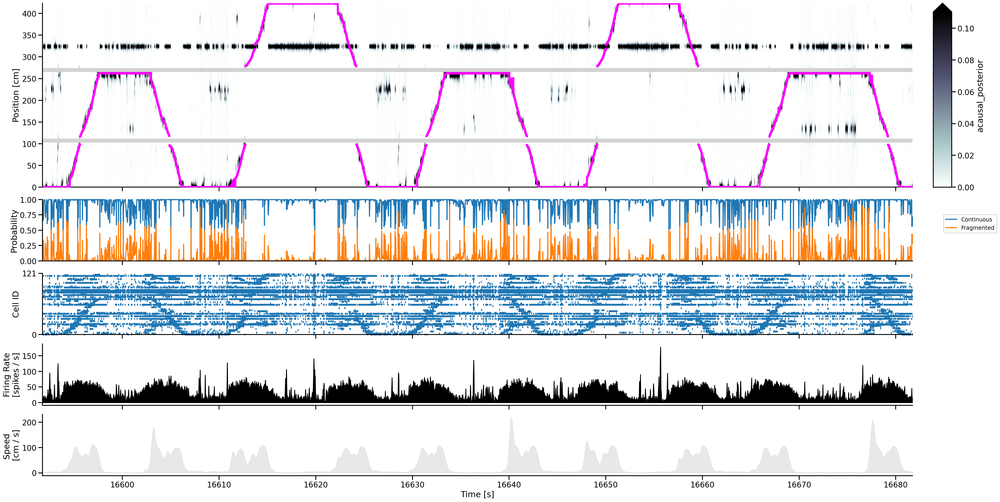

In [23]:
from src.visualization import plot_classifier_spikes

plot_classifier_spikes(
    results.time[slice(115_000, 160_000)],
    classifier,
    results,
    data,
    posterior_type="acausal_posterior",
    figsize=(30, 15),
    legend=True,
)

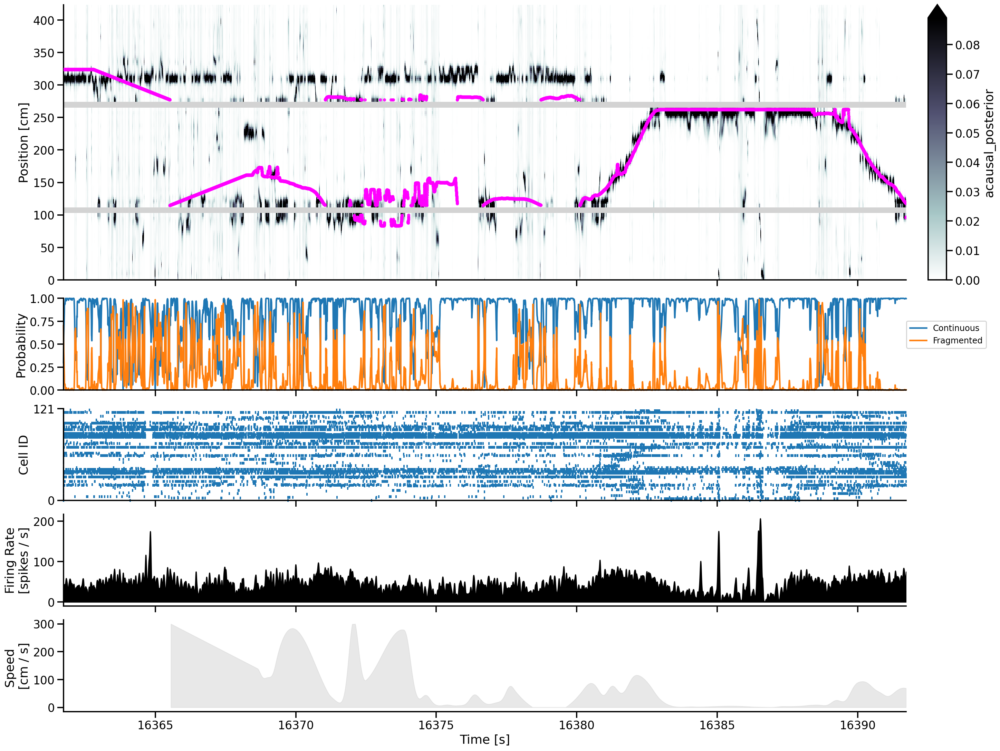

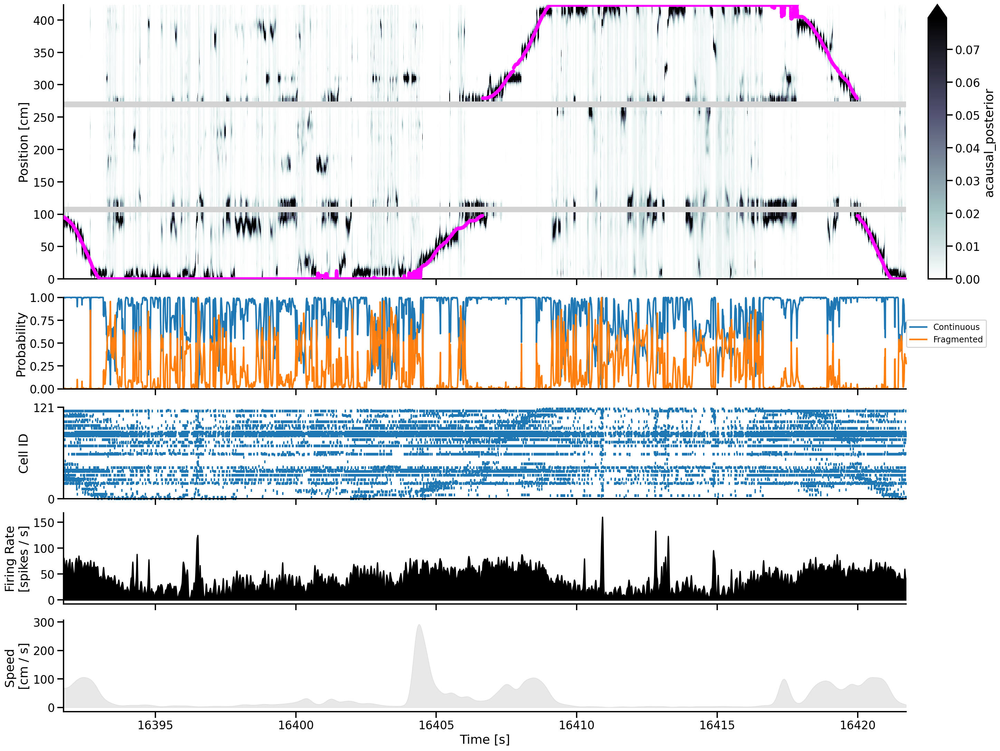

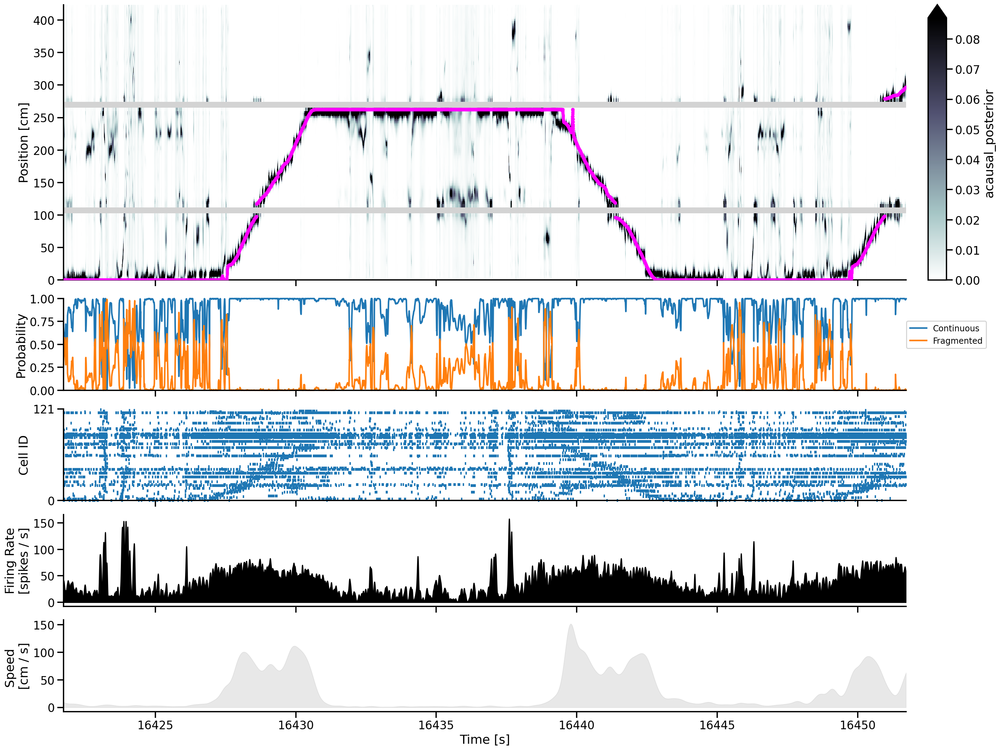

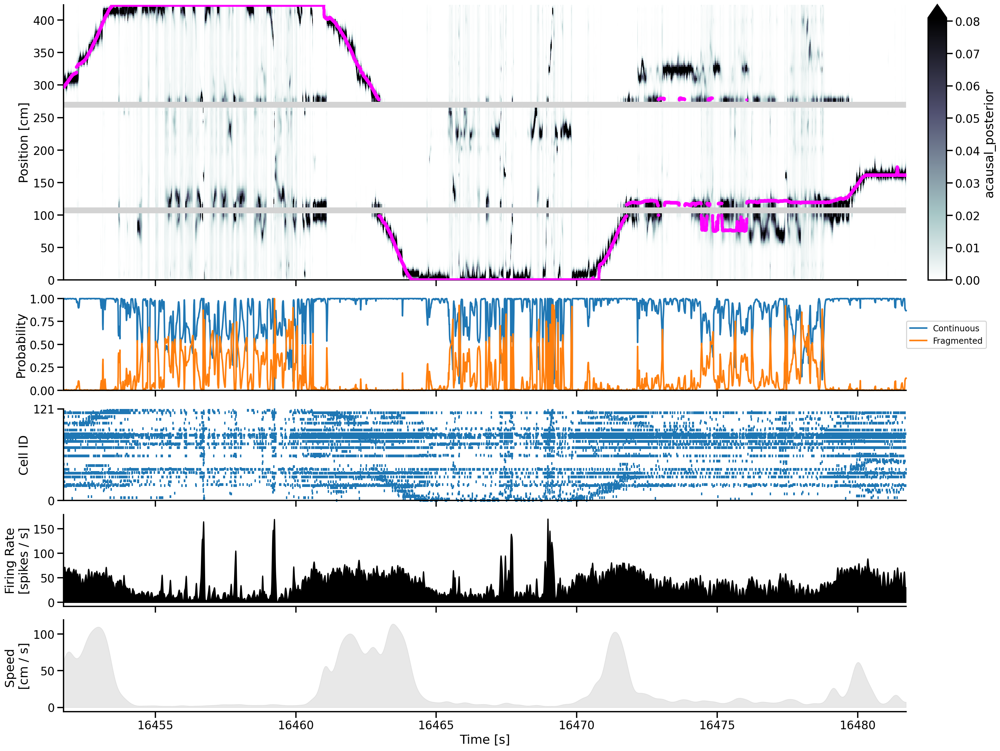

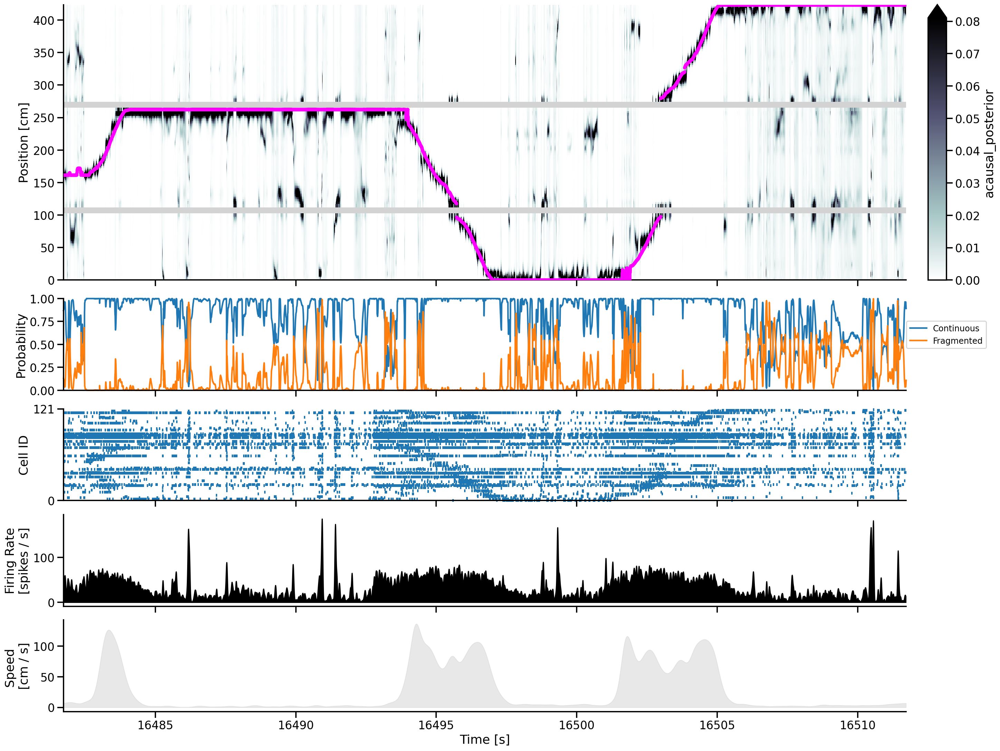

...

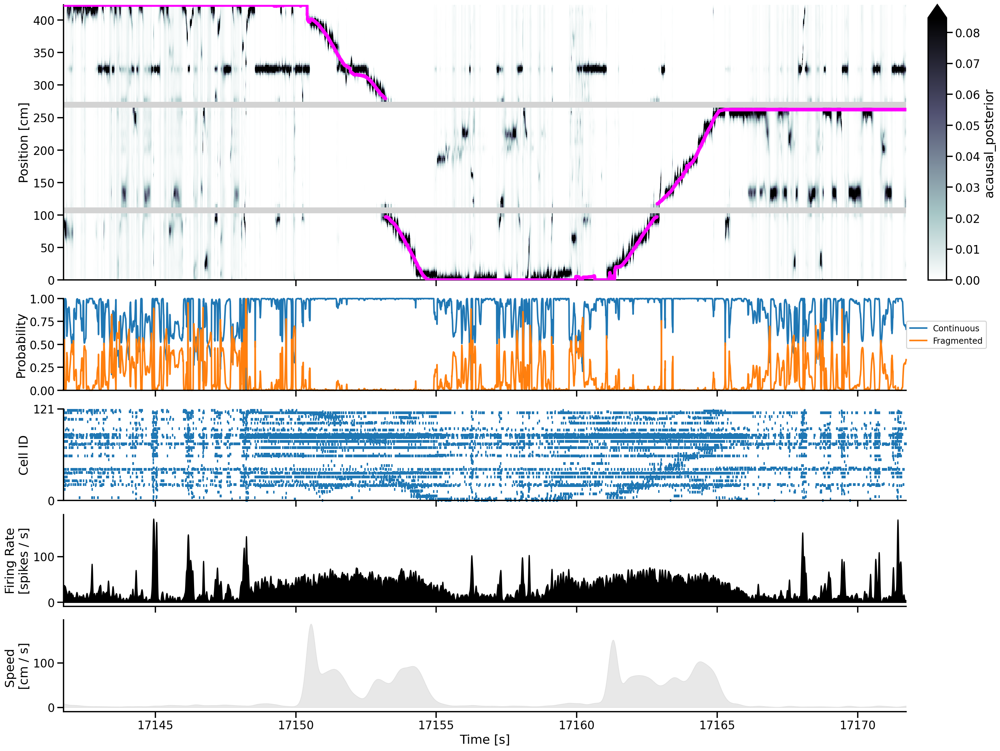

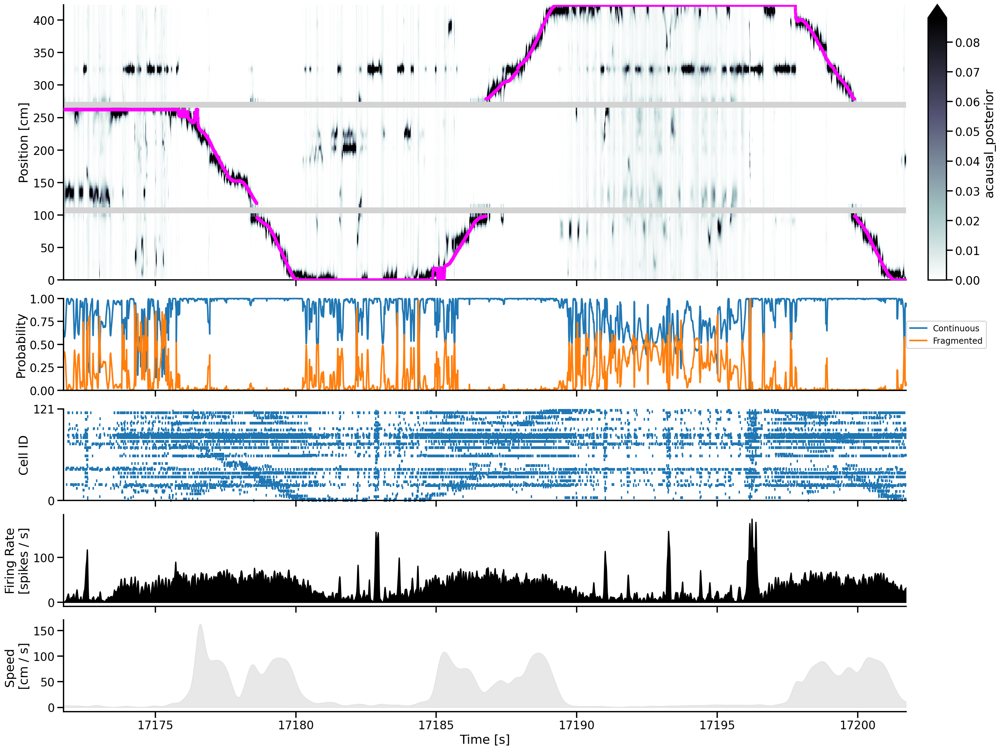

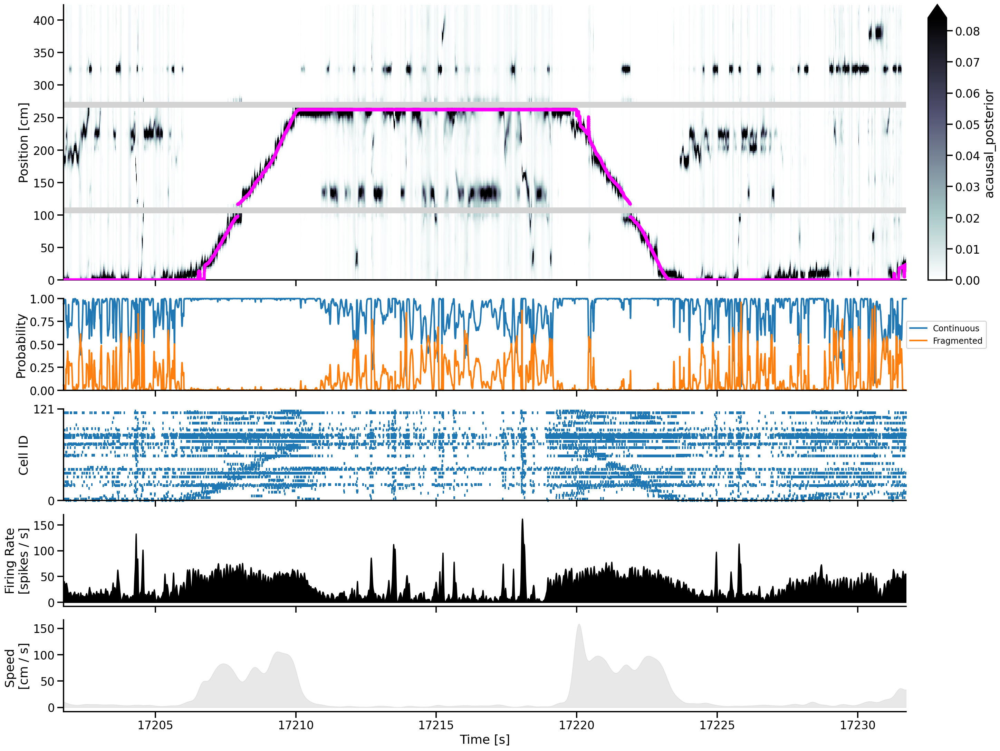

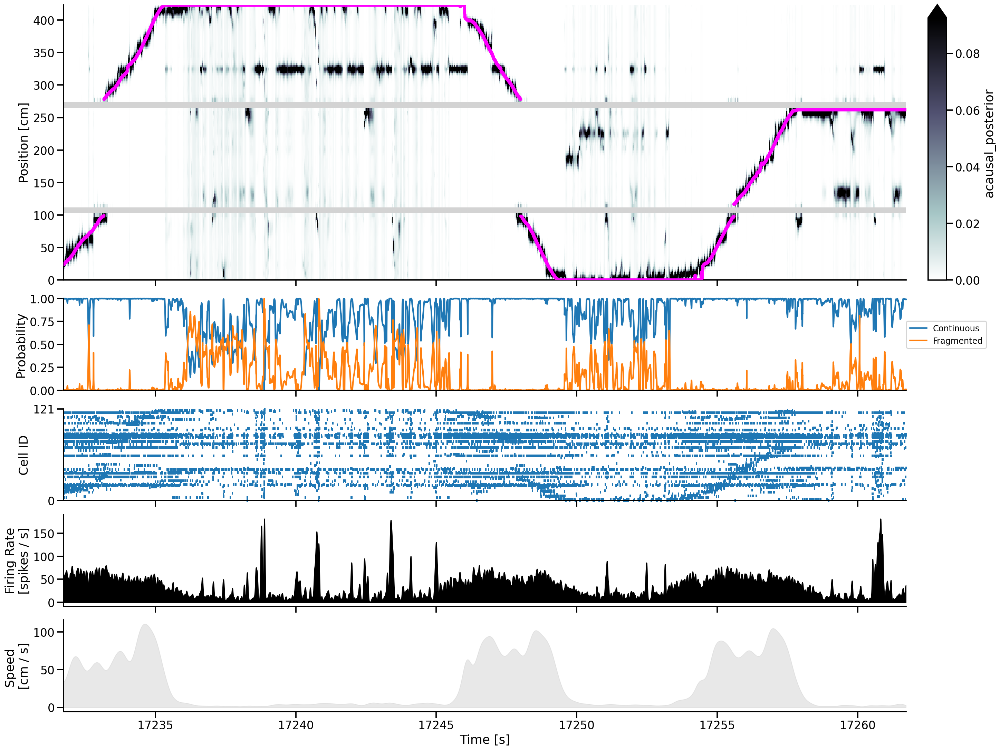

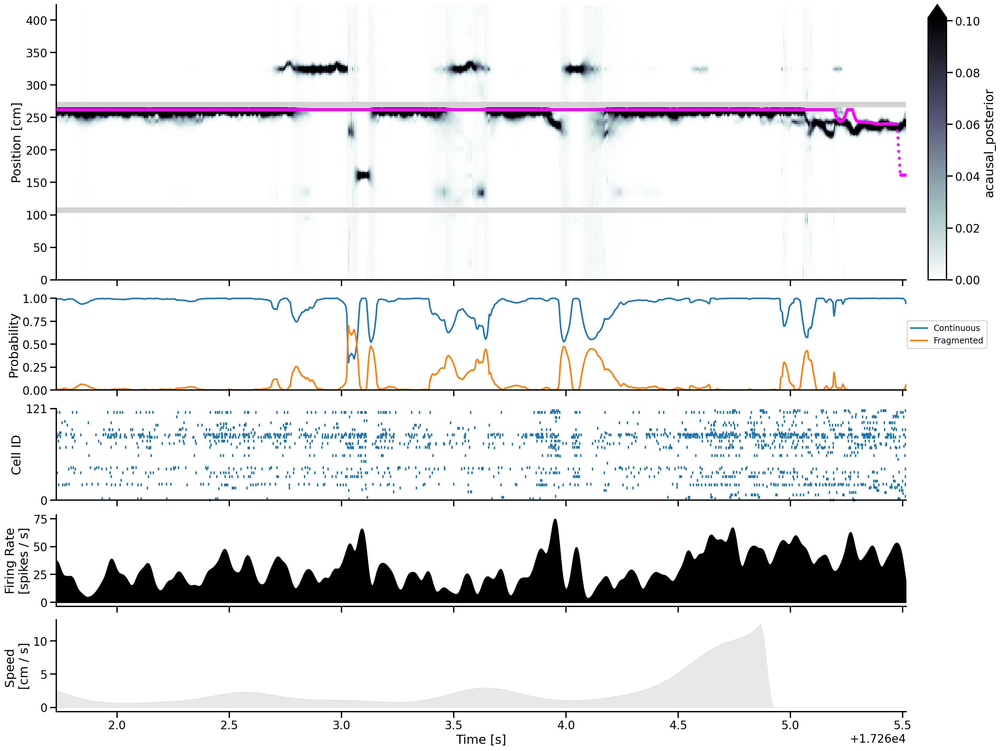

In [26]:
from src.visualization import plot_classifier_spikes

n_time = results.time.shape[0]
time_slice_step = 15_000
time_range = zip(range(0, n_time, time_slice_step),
                 range(time_slice_step, n_time + time_slice_step,
                       time_slice_step))

for start_ind, end_ind in time_range:
    plot_classifier_spikes(
        results.time[slice(start_ind, end_ind)],
        classifier,
        results,
        data,
        posterior_type="acausal_posterior",
        figsize=(20, 15),
    )

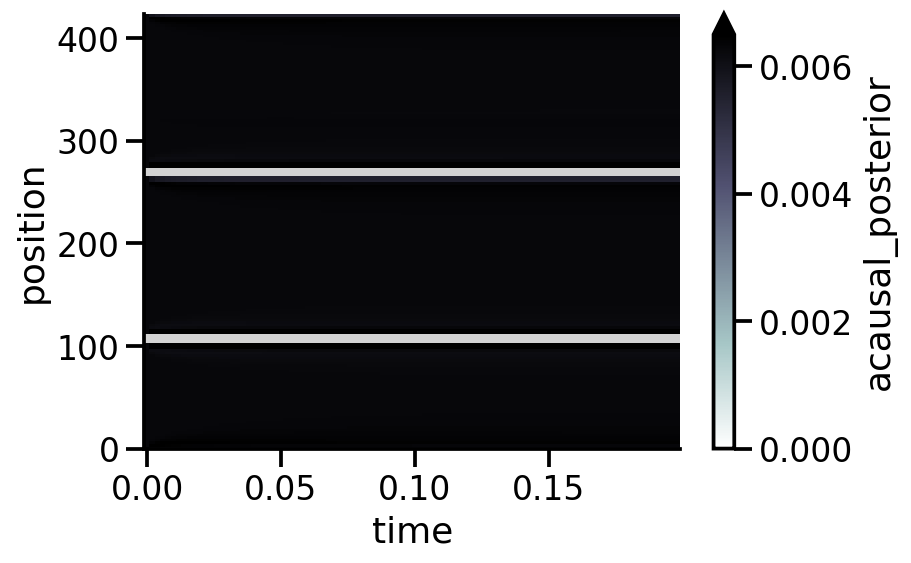

In [24]:
import copy
import matplotlib.pyplot as plt
from src.parameters import SAMPLING_FREQUENCY

n_neurons = data['spikes'].shape[1]
n_time = 100

no_spike_results = (
    predict(
        classifier, 
        np.zeros((n_time, n_neurons)),
        time=np.arange(n_time) / SAMPLING_FREQUENCY,
        state_names=state_names
    )
)

cmap = copy.copy(plt.get_cmap('bone_r'))
cmap.set_bad(color="lightgrey", alpha=1.0)

(no_spike_results
 .acausal_posterior
 .sum('state')
 .where(classifier.is_track_interior_)
 .plot(x='time', y='position', robust=True, vmin=0.0, cmap=cmap))
sns.despine()

Text(0.5, 1.0, 'No Spike Likelihood')

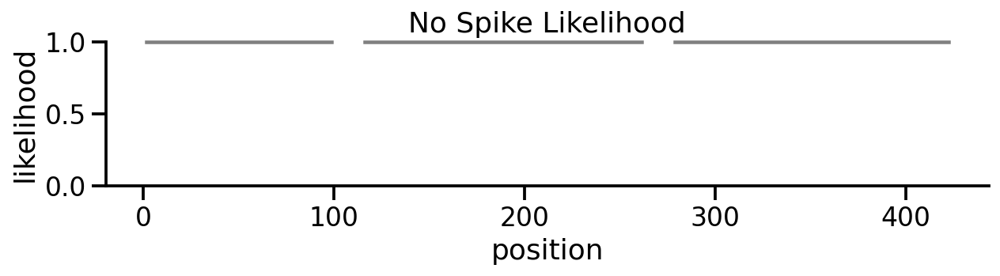

In [25]:
fig, ax = plt.subplots(figsize=(10, 5 / 3))
no_spike_results.likelihood.isel(time=0, state=0).plot(
    x='position', color='grey', clip_on=False, ax=ax)
plt.ylim((0, 1))
sns.despine()
plt.title('No Spike Likelihood')


## DIO

In [28]:
from loren_frank_data_processing.DIO import get_DIO
from src.parameters import ANIMALS

dio = get_DIO(epoch_key, ANIMALS)

In [29]:
dio

,Din1,Din2,Din3,Din4,Din5,Din6,Din7,Din8,Din9,Din10,...,Dout23,Dout24,Dout25,Dout26,Dout27,Dout28,Dout29,Dout30,Dout31,Dout32
0 days 04:32:35.865700,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0 days 04:32:35.872166667,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0 days 04:32:35.873200,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0 days 04:32:35.880166667,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0 days 04:32:35.881200,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0 days 04:47:45.515233332,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0 days 04:47:45.516266667,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0 days 04:47:45.523233332,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0 days 04:47:45.524266667,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


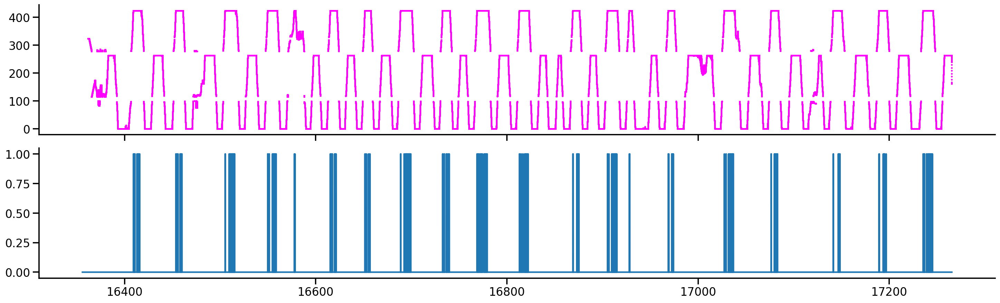

In [44]:
fig, axes = plt.subplots(2, 1, figsize=(20, 6), sharex=True, constrained_layout=True)
axes[0].scatter(data['position_info'].index / np.timedelta64(1, 's'), data['position_info'].linear_position, s=1, color='magenta')
axes[1].step(dio.index / np.timedelta64(1, 's'), dio.Din1)
sns.despine()

In [45]:
from loren_frank_data_processing.DIO import get_DIO_indicator

def _time(*args, **kwargs):
    return data['position_info'].index

dio_indicator = get_DIO_indicator(epoch_key, ANIMALS, time_function=_time)
dio_indicator

,Din1,Din2,Din3,Din4,Din5,Din6,Din7,Din8,Din9,Din10,...,Dout23,Dout24,Dout25,Dout26,Dout27,Dout28,Dout29,Dout30,Dout31,Dout32
time,,,,,,,,,,,,,,,,,,,,,
0 days 04:32:41.729892304,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0 days 04:32:41.731892304,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0 days 04:32:41.733892304,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0 days 04:32:41.735892304,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0 days 04:32:41.737892304,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0 days 04:47:45.505892304,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0 days 04:47:45.507892304,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0 days 04:47:45.509892304,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


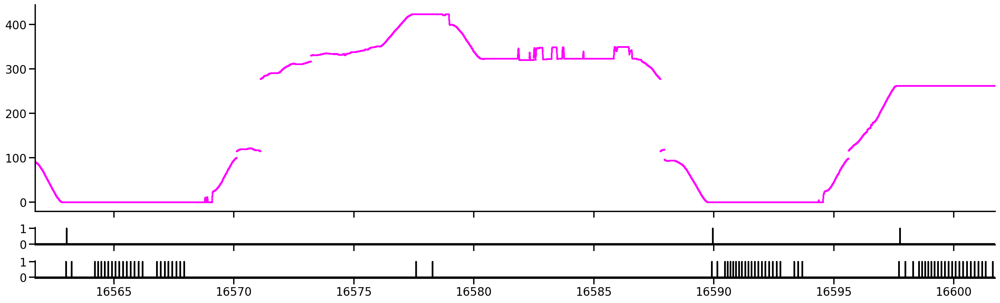

In [88]:
fig, axes = plt.subplots(3, 1, figsize=(20, 6), sharex=True, constrained_layout=True,  gridspec_kw={"height_ratios": [3, 0.25, 0.25]},)
axes[0].scatter(data['position_info'].index / np.timedelta64(1, 's'), data['position_info'].linear_position, s=1, color='magenta')
axes[1].step(dio_indicator.index / np.timedelta64(1, 's'), dio_indicator.Dout4, color='black')
axes[1].step(dio_indicator.index / np.timedelta64(1, 's'), dio_indicator.Dout5, color='black')
axes[1].step(dio_indicator.index / np.timedelta64(1, 's'), dio_indicator.Dout6, color='black')
axes[2].step(dio_indicator.index / np.timedelta64(1, 's'), dio_indicator.Din2, color='black')
axes[2].step(dio_indicator.index / np.timedelta64(1, 's'), dio_indicator.Din3, color='black')
axes[2].step(dio_indicator.index / np.timedelta64(1, 's'), dio_indicator.Din1, color='black')
sns.despine(ax=axes[1])
sns.despine(ax=axes[2])

plt.xlim((dio_indicator.index[100_000] / np.timedelta64(1, 's'), dio_indicator.index[120_000] / np.timedelta64(1, 's')))
sns.despine()

In [60]:
dio.iloc[:, np.nonzero(dio.sum().tolist())[0]]

,Din1,Din2,Din3,Din15,Dout4,Dout5,Dout6
0 days 04:32:35.865700,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0 days 04:32:35.872166667,0.0,0.0,0.0,1.0,0.0,0.0,0.0
0 days 04:32:35.873200,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0 days 04:32:35.880166667,0.0,0.0,0.0,1.0,0.0,0.0,0.0
0 days 04:32:35.881200,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...
0 days 04:47:45.515233332,0.0,0.0,0.0,1.0,0.0,0.0,0.0
0 days 04:47:45.516266667,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0 days 04:47:45.523233332,0.0,0.0,0.0,1.0,0.0,0.0,0.0
0 days 04:47:45.524266667,0.0,0.0,0.0,0.0,0.0,0.0,0.0


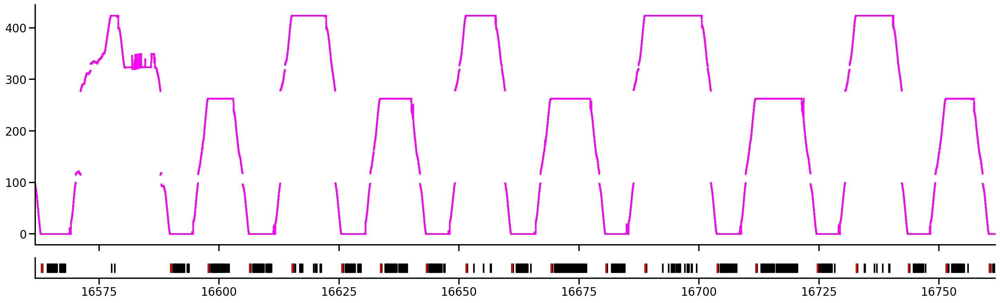

In [101]:
fig, axes = plt.subplots(2, 1, figsize=(20, 6), sharex=True, constrained_layout=True,  gridspec_kw={"height_ratios": [3, 0.25]},)
axes[0].scatter(data['position_info'].index / np.timedelta64(1, 's'), data['position_info'].linear_position, s=1, color='magenta')
axes[1].eventplot(dio.index[dio.loc[:, ['Din1', 'Din2', 'Din3']].sum(axis=1) > 0] / np.timedelta64(1, 's'), color='black')
axes[1].eventplot(dio.index[dio.loc[:, ['Dout4', 'Dout5', 'Dout6']].sum(axis=1) > 0] / np.timedelta64(1, 's'), color='red')
axes[1].set_yticks([])
sns.despine(ax=axes[1], bottom=False)

plt.xlim((dio_indicator.index[100_000] / np.timedelta64(1, 's'), dio_indicator.index[200_000] / np.timedelta64(1, 's')))
sns.despine()



In [106]:
import pandas as pd

pd.DataFrame(data['multiunit_spikes'], index=data['position_info'].index)

,0,1,2,3,4,5,6,7,8,9,...,18,19,20,21,22,23,24,25,26,27
time,,,,,,,,,,,,,,,,,,,,,
0 days 04:32:41.729892304,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
0 days 04:32:41.731892304,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
0 days 04:32:41.733892304,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0 days 04:32:41.735892304,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
0 days 04:32:41.737892304,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0 days 04:47:45.505892304,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
0 days 04:47:45.507892304,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
0 days 04:47:45.509892304,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
